Refs:\
https://github.com/deep-learning-with-pytorch/dlwpt-code

### Pretrained networks

In [1]:
from torchvision import models

In [2]:
dir(models)

['AlexNet',
 'DenseNet',
 'GoogLeNet',
 'GoogLeNetOutputs',
 'Inception3',
 'InceptionOutputs',
 'MNASNet',
 'MobileNetV2',
 'ResNet',
 'ShuffleNetV2',
 'SqueezeNet',
 'VGG',
 '_GoogLeNetOutputs',
 '_InceptionOutputs',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '_utils',
 'alexnet',
 'densenet',
 'densenet121',
 'densenet161',
 'densenet169',
 'densenet201',
 'detection',
 'googlenet',
 'inception',
 'inception_v3',
 'mnasnet',
 'mnasnet0_5',
 'mnasnet0_75',
 'mnasnet1_0',
 'mnasnet1_3',
 'mobilenet',
 'mobilenet_v2',
 'quantization',
 'resnet',
 'resnet101',
 'resnet152',
 'resnet18',
 'resnet34',
 'resnet50',
 'resnext101_32x8d',
 'resnext50_32x4d',
 'segmentation',
 'shufflenet_v2_x0_5',
 'shufflenet_v2_x1_0',
 'shufflenet_v2_x1_5',
 'shufflenet_v2_x2_0',
 'shufflenetv2',
 'squeezenet',
 'squeezenet1_0',
 'squeezenet1_1',
 'utils',
 'vgg',
 'vgg11',
 'vgg11_bn',
 'vgg13',
 'vgg13_bn',
 'vgg16',
 'vg

In [3]:
len(dir(models))

72

In [4]:
alexnet = models.AlexNet()

In [5]:
resnet = models.resnet101(pretrained=True)

In [6]:
resnet

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

### Preprocess input images

In [7]:
from torchvision import transforms

In [8]:
preprocess = transforms.Compose([
        transforms.Resize(256),       ## scale the input image to 256 x 256
        transforms.CenterCrop(224),   ## crop the image to 224 x 224 around the center 
        transforms.ToTensor(),        ## transform it to a tensor
        transforms.Normalize(         ## normalize its RGB components
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        )])

In [9]:
from PIL import Image
img = Image.open("../../data/image_kangaroo.jpg")

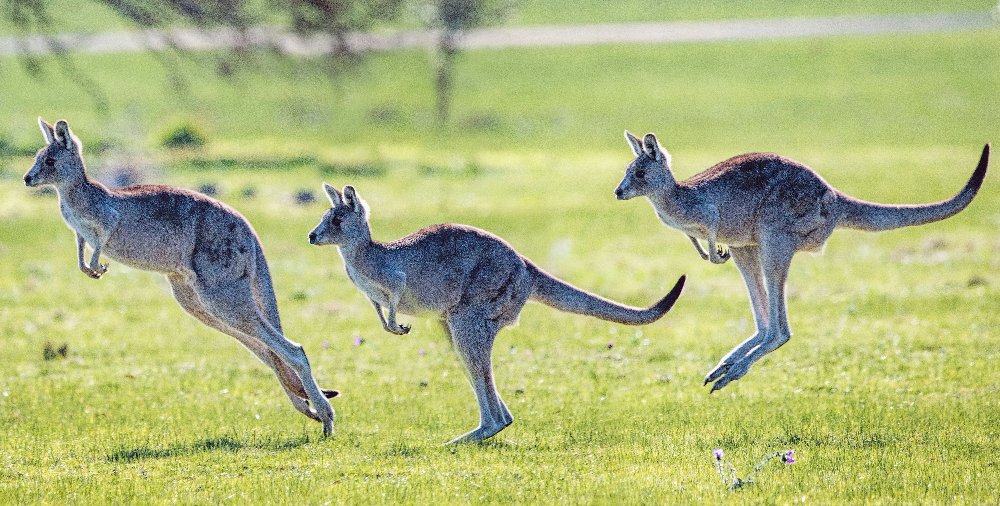

In [10]:
img

In [11]:
img_t = preprocess(img)

In [12]:
img_t

tensor([[[ 0.8789,  0.7933,  0.7419,  ...,  1.8037,  1.7865,  1.7352],
         [ 1.0502,  1.0673,  1.0502,  ...,  1.7694,  1.7352,  1.6838],
         [ 1.1358,  1.1700,  1.2214,  ...,  1.6324,  1.6324,  1.5982],
         ...,
         [ 0.4851,  0.1254,  0.8276,  ...,  1.6667,  1.1529,  1.5468],
         [ 0.8618,  1.0502,  1.3070,  ...,  1.7865,  1.5639,  1.4098],
         [ 1.3070,  1.2899,  1.4612,  ...,  1.5982,  1.4098,  1.5468]],

        [[ 1.0630,  1.0105,  0.9580,  ...,  1.8859,  1.8683,  1.8508],
         [ 1.1681,  1.1856,  1.1856,  ...,  1.8508,  1.8508,  1.8333],
         [ 1.2031,  1.2381,  1.3081,  ...,  1.7808,  1.7808,  1.7633],
         ...,
         [ 0.6954,  0.1877,  0.8880,  ...,  1.8683,  1.4307,  1.8158],
         [ 1.0455,  1.1155,  1.3606,  ...,  1.9734,  1.8333,  1.6758],
         [ 1.5182,  1.4832,  1.6232,  ...,  1.8333,  1.6933,  1.7633]],

        [[ 0.9668,  0.8622,  0.7925,  ...,  2.0823,  2.0648,  2.0300],
         [ 1.1585,  1.1411,  1.1237,  ...,  2

In [13]:
img_t.shape

torch.Size([3, 224, 224])

In [14]:
import torch

In [15]:
## reshape the input tensor in a way that the network expects:
batch_t = torch.unsqueeze(img_t, 0)

In [16]:
batch_t

tensor([[[[ 0.8789,  0.7933,  0.7419,  ...,  1.8037,  1.7865,  1.7352],
          [ 1.0502,  1.0673,  1.0502,  ...,  1.7694,  1.7352,  1.6838],
          [ 1.1358,  1.1700,  1.2214,  ...,  1.6324,  1.6324,  1.5982],
          ...,
          [ 0.4851,  0.1254,  0.8276,  ...,  1.6667,  1.1529,  1.5468],
          [ 0.8618,  1.0502,  1.3070,  ...,  1.7865,  1.5639,  1.4098],
          [ 1.3070,  1.2899,  1.4612,  ...,  1.5982,  1.4098,  1.5468]],

         [[ 1.0630,  1.0105,  0.9580,  ...,  1.8859,  1.8683,  1.8508],
          [ 1.1681,  1.1856,  1.1856,  ...,  1.8508,  1.8508,  1.8333],
          [ 1.2031,  1.2381,  1.3081,  ...,  1.7808,  1.7808,  1.7633],
          ...,
          [ 0.6954,  0.1877,  0.8880,  ...,  1.8683,  1.4307,  1.8158],
          [ 1.0455,  1.1155,  1.3606,  ...,  1.9734,  1.8333,  1.6758],
          [ 1.5182,  1.4832,  1.6232,  ...,  1.8333,  1.6933,  1.7633]],

         [[ 0.9668,  0.8622,  0.7925,  ...,  2.0823,  2.0648,  2.0300],
          [ 1.1585,  1.1411,  

In [17]:
batch_t.shape

torch.Size([1, 3, 224, 224])

### Run the model

In [18]:
## First of all, we need to put the network in `eval` mode:
resnet.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [19]:
out = resnet(batch_t)

In [20]:
out

tensor([[-1.0868e+00, -2.6893e+00, -2.6171e+00, -1.1359e+00,  8.3076e-01,
         -1.0484e+00, -2.4287e+00,  1.8579e+00,  1.1571e+00,  5.1395e+00,
          7.4167e-01,  3.2329e-01, -4.1822e-01,  1.8608e-01,  1.1926e+00,
         -1.9269e-01,  8.0199e-01,  1.7833e+00,  1.4186e+00, -6.5768e-02,
          6.1046e-01,  1.1543e+00, -1.8959e+00,  1.9611e+00, -4.9279e-01,
         -1.4117e+00,  7.3415e-01, -1.0956e-01,  2.6208e-02,  6.1728e-01,
         -3.8322e-01, -4.5948e-01, -2.0148e-01, -3.1636e+00, -1.2834e+00,
         -1.6088e+00, -1.1310e+00, -6.1893e-01,  1.1977e+00,  9.6779e-01,
          2.4004e+00,  7.8769e-01,  4.2597e-01,  3.9593e-01,  1.2366e+00,
         -2.5366e+00,  2.4625e+00,  3.1537e+00,  8.4751e-01,  2.8281e+00,
          2.1427e+00,  3.1275e+00, -3.2926e-01, -1.2157e+00, -1.7387e+00,
         -1.6702e+00, -3.1099e+00, -1.7238e+00, -5.5313e-01,  5.1998e-01,
         -7.5357e-01, -5.9727e-01, -1.4162e+00, -2.2633e+00, -7.9271e-01,
         -1.5683e+00, -4.1855e-01, -7.

In [21]:
out.shape  ## --> the output is a vector of 1,000 scores, one per class

torch.Size([1, 1000])

In [22]:
# load the file containing the 1,000 labels for the ImageNet dataset:
with open('../../data/imagenet_classes.txt') as f:
    labels = [line.strip() for line in f.readlines()]

In [23]:
labels

['tench, Tinca tinca',
 'goldfish, Carassius auratus',
 'great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias',
 'tiger shark, Galeocerdo cuvieri',
 'hammerhead, hammerhead shark',
 'electric ray, crampfish, numbfish, torpedo',
 'stingray',
 'cock',
 'hen',
 'ostrich, Struthio camelus',
 'brambling, Fringilla montifringilla',
 'goldfinch, Carduelis carduelis',
 'house finch, linnet, Carpodacus mexicanus',
 'junco, snowbird',
 'indigo bunting, indigo finch, indigo bird, Passerina cyanea',
 'robin, American robin, Turdus migratorius',
 'bulbul',
 'jay',
 'magpie',
 'chickadee',
 'water ouzel, dipper',
 'kite',
 'bald eagle, American eagle, Haliaeetus leucocephalus',
 'vulture',
 'great grey owl, great gray owl, Strix nebulosa',
 'European fire salamander, Salamandra salamandra',
 'common newt, Triturus vulgaris',
 'eft',
 'spotted salamander, Ambystoma maculatum',
 'axolotl, mud puppy, Ambystoma mexicanum',
 'bullfrog, Rana catesbeiana',
 'tree frog, tree-f

In [24]:
len(labels)

1000

In [25]:
## find the index coresponding score_max:
score_max, index = torch.max(out, 1)

In [29]:
score_max

tensor([11.5343], grad_fn=<MaxBackward0>)

In [30]:
index

tensor([104])

In [32]:
## note that the index is not a plain Python number, use index[0] to get the actual numerical value 
index[0]

tensor(104)

In [34]:
# normalize outputs to the range[0,1] and devide by the sum
percentage = torch.nn.functional.softmax(out, dim=1)

In [35]:
percentage

tensor([[2.3950e-06, 4.8234e-07, 5.1847e-07, 2.2803e-06, 1.6296e-05, 2.4887e-06,
         6.2593e-07, 4.5518e-05, 2.2584e-05, 1.2116e-03, 1.4907e-05, 9.8107e-06,
         4.6737e-06, 8.5528e-06, 2.3401e-05, 5.8562e-06, 1.5834e-05, 4.2245e-05,
         2.9335e-05, 6.6487e-06, 1.3074e-05, 2.2522e-05, 1.0664e-06, 5.0467e-05,
         4.3379e-06, 1.7306e-06, 1.4796e-05, 6.3638e-06, 7.2892e-06, 1.3164e-05,
         4.8402e-06, 4.4848e-06, 5.8049e-06, 3.0016e-07, 1.9676e-06, 1.4211e-06,
         2.2915e-06, 3.8238e-06, 2.3521e-05, 1.8690e-05, 7.8302e-05, 1.5609e-05,
         1.0872e-05, 1.0550e-05, 2.4453e-05, 5.6193e-07, 8.3321e-05, 1.6631e-04,
         1.6572e-05, 1.2009e-04, 6.0512e-05, 1.6201e-04, 5.1086e-06, 2.1053e-06,
         1.2479e-06, 1.3364e-06, 3.1672e-07, 1.2667e-06, 4.0839e-06, 1.1943e-05,
         3.3421e-06, 3.9076e-06, 1.7228e-06, 7.3848e-07, 3.2139e-06, 1.4797e-06,
         4.6722e-06, 3.2219e-06, 5.9105e-06, 4.2140e-07, 5.6872e-06, 5.4156e-05,
         1.0339e-05, 5.5779e

In [36]:
percentage.shape

torch.Size([1, 1000])

In [39]:
percentage = torch.nn.functional.softmax(out, dim=1)[0]*100

In [40]:
print(labels[index[0]])

wallaby, brush kangaroo


In [43]:
percentage[index[0]]

tensor(72.5396, grad_fn=<SelectBackward>)

In [44]:
# convert tensor to plain Python:
percentage[index[0]].item()

72.53959655761719

In [46]:
## find the second best, third best,... :
## sort the values in desending
_, indices = torch.sort(out, descending=True)

[(labels[idx], percentage[idx].item()) for idx in indices[0][:5]]

[('wallaby, brush kangaroo', 72.53959655761719),
 ('coyote, prairie wolf, brush wolf, Canis latrans', 7.581150531768799),
 ('gazelle', 4.38139009475708),
 ('llama', 3.707230806350708),
 ('hare', 1.609606146812439)]